In [13]:
import numpy as np
from matplotlib import pyplot as plt
import pandas as pd
from sklearn.cluster import KMeans
from scipy import stats
from pathlib import Path
import pynapple as nap
from scipy.ndimage import gaussian_filter, rotate

from spatial_manifolds.data.binning import get_bin_config
from spatial_manifolds.data.loading import load_session

import warnings
warnings.filterwarnings('ignore')
%load_ext autoreload
%autoreload 2

save_path = '/Users/harryclark/Documents/figs/Ianfigs'

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [14]:
mouse = 0
day = 0
session_type = ''
sorter = 'kilosort4'
storage = Path('/Users/harryclark/Downloads/COHORT12_nolfp/')
#storage = Path('/Users/harryclark/Downloads/nwb_data/')

alpha = 0.001
n_jobs = 8
n_shuffles = 100
seed = 1

class Args:
    def __init__(self,mouse,day,session_type,sorter,storage,alpha,n_jobs,n_shuffles,seed):
        self.mouse = mouse
        self.day = day
        self.session_type = session_type
        self.sorter = sorter
        self.storage = storage
        self.alpha = alpha
        self.n_jobs = n_jobs
        self.n_shuffles = n_shuffles
        self.seed = seed
args = Args(mouse,day,session_type,sorter,storage,alpha,n_jobs,n_shuffles,seed)

if session_type == 'VR':
    tl = 200
elif session_type == 'MCVR':
    tl = 230


In [15]:
# All mice!
# Load session
sessions = {}
for session_path in sorted(
    list(args.storage.glob(f'*/*/MCVR/*MCVR.nwb'))
):
    args.mouse = int(session_path.parent.parent.parent.name[1:])
    args.day = int(session_path.parent.parent.name[1:])
    args.session_type = session_path.parent.name

    mouse_day_sesh = f'M{args.mouse}D{args.day}{args.session_type}'
    sessions[mouse_day_sesh] = (
        *load_session(args),
        pd.read_parquet(
            session_path.parent / 'tuning_scores' / 'ramp_class.parquet'
        ),
    )
bin_config = get_bin_config(args.session_type)['P']

In [16]:
    
def plot_example(tc, bin_centres, title, save_path=''):
    fig, ax = plt.subplots(
        1, 1, layout='constrained', figsize=(2, 2)
    )
    for tt, tt_c in zip(['rz1','rz2'], ['black', '#6a95bf']):
        tt_tc = tc[f'{tt}']
        mean = np.nanmean(tt_tc, axis=0)
        sem = stats.sem(tt_tc, axis=0, nan_policy='omit')
        ax.plot(bin_centres, mean, color=tt_c)
        ax.fill_between(
            bin_centres, mean - sem, mean + sem, alpha=0.2, color=tt_c
            )
    ax.set_title(
        f'{title}',
        fontsize=8,
    )
    ax.set_xlim(0,230)
    ax.set_xlabel('position (cm)')
    ax.set_ylabel('firing rate (Hz)')

    ax.axvspan(
        90,110,
        alpha=0.2,
        zorder=-10,
        edgecolor='none',
        facecolor='orange',
    )
    ax.axvspan(
        120,140,
        alpha=0.2,
        zorder=-10,
        edgecolor='none',
        facecolor='teal',
    )
    ax.axvspan(
    0,
    30,
    alpha=0.2,
    zorder=-10,
    edgecolor='none',
    facecolor='grey',
    )
    ax.axvspan(
    200,
    230,
    alpha=0.2,
    zorder=-10,
    edgecolor='none',
    facecolor='grey',
    )
    plt.savefig(f'{save_path}/{title}_runs.pdf', dpi=300)
    plt.show()



('+', ' ')
for ramp class('+', ' '), there is 890 found
for ramp class('+', ' '), there is 890 found


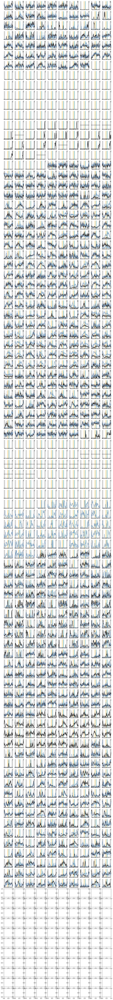

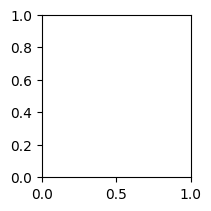

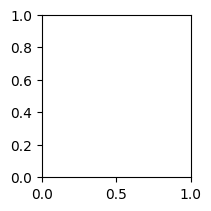

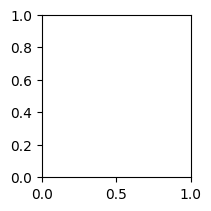

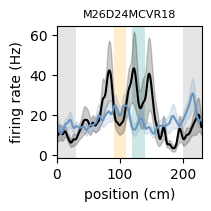

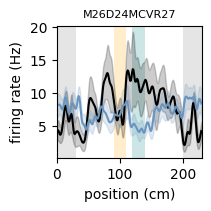

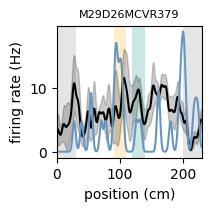

('+', '+')
for ramp class('+', '+'), there is 148 found
for ramp class('+', '+'), there is 148 found


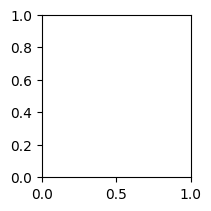

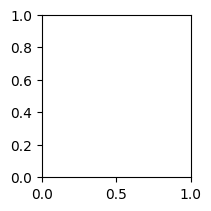

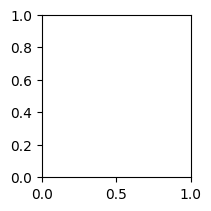

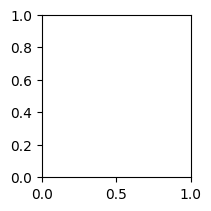

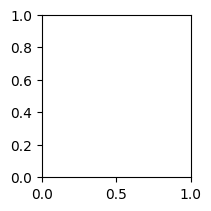

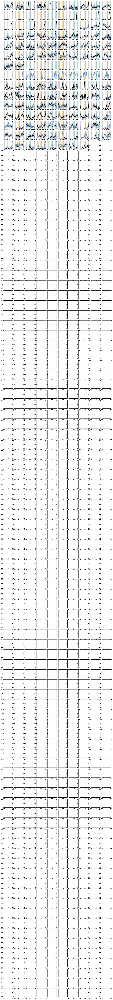

('+', '-')
for ramp class('+', '-'), there is 303 found
for ramp class('+', '-'), there is 303 found


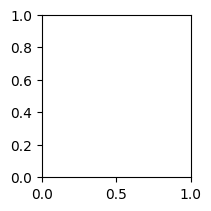

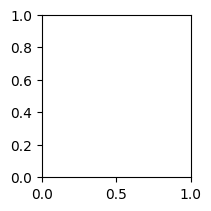

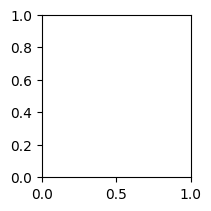

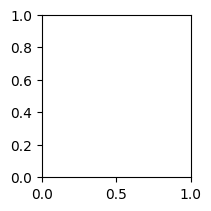

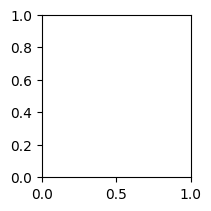

...

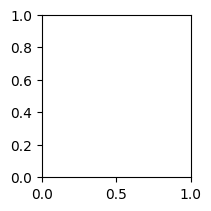

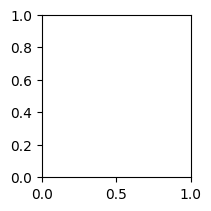

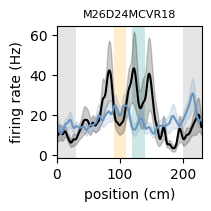

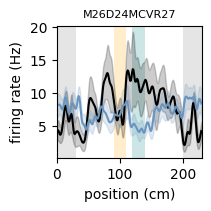

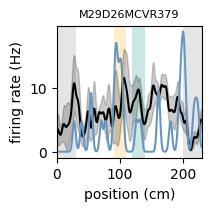

('+', '/')
for ramp class('+', '/'), there is 439 found
for ramp class('+', '/'), there is 439 found


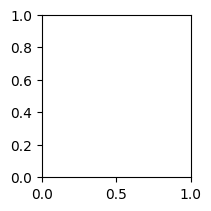

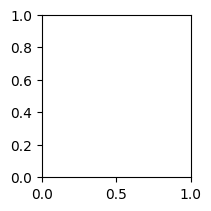

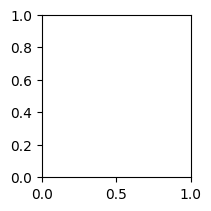

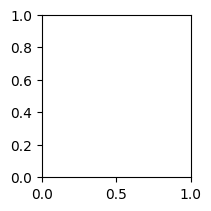

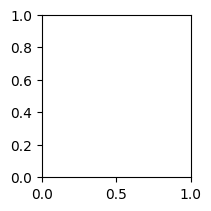

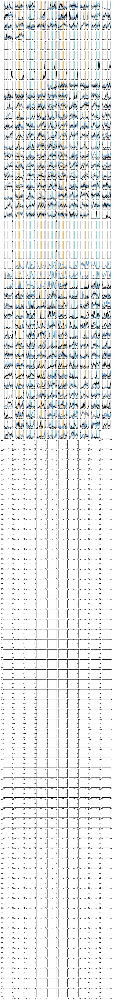

('-', ' ')
for ramp class('-', ' '), there is 2574 found


IndexError: index 100 is out of bounds for axis 0 with size 100

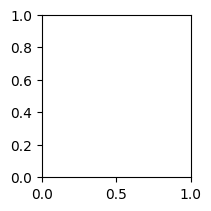

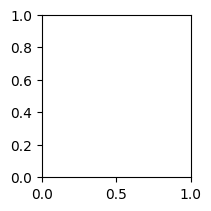

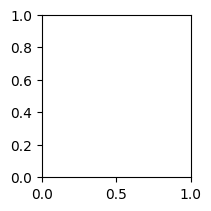

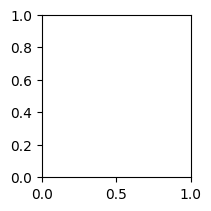

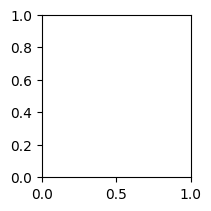

...

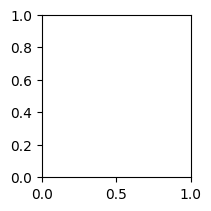

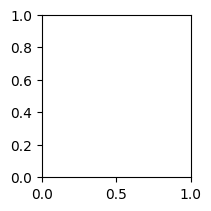

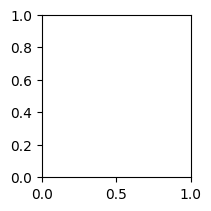

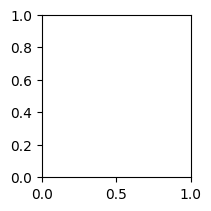

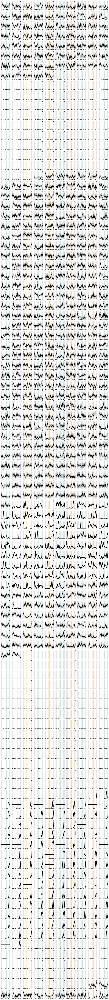

In [17]:

bin_config = get_bin_config(args.session_type)['P']
# Plot
trial_types = [1,3]

trial_types = ['b','nb']
trial_contexts = ['rz1', 'rz2']

ramp_classes = [('+',' '),
                ('+','+'), 
                ('+','-'),
                ('+','/'),
                ('-',' '),
                ('-','+'), 
                ('-','-'),
                ('-','/')]

examplar_cell_ids = ['M25D29MCVR112',
                     'M25D29MCVR287',
                     'M25D29MCVR265',
                     'M26D24MCVR18',
                     'M26D24MCVR27',
                     'M29D26MCVR379',
                     'M29D26MCVR414',
                     'M29D24MCVR130',
                     'M29D24MCVR129',
                     'M28D29MCVR342',
                     'M28D29MCVR340',
]

for class_idx, ramp_class in enumerate(ramp_classes):
    examplar_tcs = {}
    for unique_idx in examplar_cell_ids:
        examplar_tcs[unique_idx] = {}

    print(ramp_class)

    ncols = 10
    nrows = int(np.ceil(1000/ncols))
    fig, axs = plt.subplots(ncols=ncols, nrows=nrows, 
                           figsize=(15, 4*(np.ceil(840/6)/4)), squeeze=False)
    
    for trial_context, tt_c, mt in zip(trial_contexts, ['black', '#6a95bf'], [0, 0.1]):
        tcs = {}

        for day_idx, (
            day,
            (session, session_path, clusters, ramp_table),
        ) in enumerate(sessions.items()):
            
            subset_ids1 = ramp_table[
                (ramp_table['group'] == 'rz1_nb')
                & (ramp_table['sign'] == ramp_class[0])
                & (ramp_table['region'] == 'outbound')
            ]['cluster_id'].values

            if ramp_class[1] != ' ':
                subset_ids2 = ramp_table[
                    (ramp_table['group'] == 'rz1_nb')
                    & (ramp_table['sign'] == ramp_class[1])
                    & (ramp_table['region'] == 'homebound')
                ]['cluster_id'].values
                subset_ids = np.intersect1d(subset_ids1, subset_ids2)
            else:
                subset_ids = subset_ids1

            trials = session['trials'][(session['trials']['trial_result'] == 'run') &
                                       (session['trials']['trial_type'] == 'nb') &
                                       (session['trials']['trial_context'] == trial_context) ]

            n_bins = bin_config['num_bins']
            bounds = bin_config['bounds']
            sigma = bin_config['smooth_sigma']

            for index in subset_ids:
                unique_idx = f'{session.name}{index}'
                this_neuron = clusters[clusters.index == index]
                trial_tcs = []
                for tn in trials.trial_number:
                    trial = session['trials'][session['trials']['trial_number'] == tn]
                    tc = nap.compute_1d_tuning_curves(this_neuron, 
                                                    session["P"], 
                                                    nb_bins=n_bins, 
                                                    minmax=[bounds[0], bounds[1]],
                                                    ep=session["moving"].intersect(trial))[index]
                    bin_centres = tc.index
                    tc = np.nan_to_num(tc)
                    trial_tcs.append(tc)
                trial_tcs = np.array(trial_tcs)
                trial_tcs_flat = trial_tcs.flatten()
                trial_tcs_flat = gaussian_filter(np.nan_to_num(trial_tcs_flat).astype(np.float64), sigma=sigma)
                trial_tcs = trial_tcs_flat.reshape(trial_tcs.shape)
                tcs[unique_idx] = trial_tcs
                
                # save the examplar cells
                if unique_idx in examplar_cell_ids:
                    examplar_tcs[unique_idx][f'{trial_context}'] = trial_tcs
            
        # plot all of the cells
        print(f'for ramp class{ramp_class}, there is {len(tcs)} found')
        for tc_idx, unique_idx in enumerate(tcs.keys()):
            tc = tcs[unique_idx]
            axi = int(tc_idx//ncols)
            axj = int(tc_idx%ncols)

            if len(tc)>0:
                mean = np.nanmean(tc, axis=0)
                sem = stats.sem(tc, axis=0, nan_policy='omit')
                axs[axi, axj].plot(bin_centres, mean, color=tt_c)
                axs[axi, axj].fill_between(
                    bin_centres, mean - sem, mean + sem, alpha=0.2, color=tt_c
                    )
            axs[axi, axj].text(
                1.0,
                -0.05,
                f'{unique_idx}',
                fontsize=8,
                ha='right',
                transform=axs[axi, axj].transAxes,
            )
            axs[axi, axj].text(
            1.0,
            0.95-mt,
            f'{len(tc)}',
            fontsize=8,
            ha='right',
            transform=axs[axi, axj].transAxes,
            )

            axs[axi, axj].axvspan(
                90,
                110,
                alpha=0.2,
                zorder=-10,
                edgecolor='none',
                facecolor='orange',
                )
            axs[axi, axj].axvspan(
                120,
                140,
                alpha=0.2,
                zorder=-10,
                edgecolor='none',
                facecolor='teal',
                )
            axs[axi, axj].axvspan(
                0,
                30,
                alpha=0.2,
                zorder=-10,
                edgecolor='none',
                facecolor='grey',
                )
            axs[axi, axj].axvspan(
                200,
                230,
                alpha=0.2,
                zorder=-10,
                edgecolor='none',
                facecolor='grey',
                )
            axs[axi, axj].set_xlim(0,230)
            axs[axi, axj].xaxis.set_visible(False)
            axs[axi, axj].yaxis.set_visible(False)
            axs[axi, axj].spines['top'].set_visible(False)
            axs[axi, axj].spines['right'].set_visible(False)
            axs[axi, axj].spines['bottom'].set_visible(False)
            axs[axi, axj].spines['left'].set_visible(False)
    plt.savefig(f'{save_path}/zscored_ramp_classes_runs.pdf', dpi=300)

    plt.show()

    # plot example cells
    for unique_idx in examplar_tcs.keys():
        try:
            tc = examplar_tcs[unique_idx]
            plot_example(tc, bin_centres, title=unique_idx, save_path=save_path)
        except:
            continue


rampclass ('+', ' ') , len(zscored)=890
rampclass ('+', ' ') , len(zscored)=890
rampclass ('+', '+') , len(zscored)=148
rampclass ('+', '+') , len(zscored)=148
rampclass ('+', '-') , len(zscored)=303
rampclass ('+', '-') , len(zscored)=303
rampclass ('+', '/') , len(zscored)=439
rampclass ('+', '/') , len(zscored)=439
rampclass ('-', ' ') , len(zscored)=2574
rampclass ('-', ' ') , len(zscored)=2574
rampclass ('-', '+') , len(zscored)=990
rampclass ('-', '+') , len(zscored)=990
rampclass ('-', '-') , len(zscored)=160
rampclass ('-', '-') , len(zscored)=160
rampclass ('-', '/') , len(zscored)=1424
rampclass ('-', '/') , len(zscored)=1424


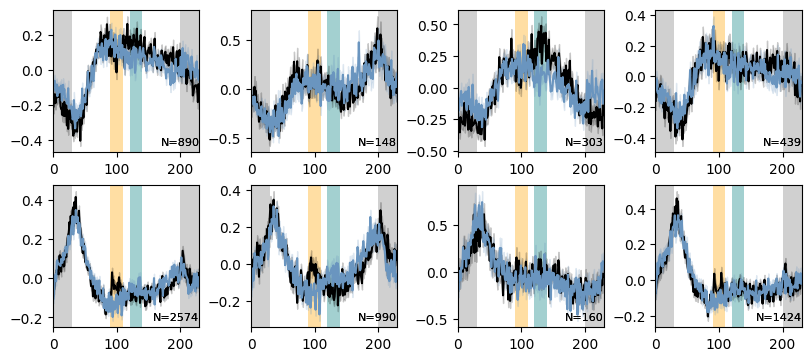

In [19]:
# Plot
trial_types = [1,3]
ramp_classes = [('+',' '),
                ('+','+'), 
                ('+','-'),
                ('+','/'),
                ('-',' '),
                ('-','+'), 
                ('-','-'),
                ('-','/')]

fig, axs = plt.subplots(
    2, 4, layout='constrained', figsize=(8, 3.5)
)

for class_idx, ramp_class in enumerate(ramp_classes):
    axi = int(class_idx // 4)
    axj = int(class_idx % 4)
    for trial_context, tt_c, mt in zip(trial_contexts, ['black', '#6a95bf'], [0, 0.1]):
        tcs_zscored = []
        for day_idx, (
            day,
            (session, session_path, clusters, ramp_table),
        ) in enumerate(sessions.items()):
            
            subset_ids1 = ramp_table[
                (ramp_table['group'] == 'rz1_nb')
                & (ramp_table['sign'] == ramp_class[0])
                & (ramp_table['region'] == 'outbound')
            ]['cluster_id'].values

            if ramp_class[1] != ' ':
                subset_ids2 = ramp_table[
                    (ramp_table['group'] == 'rz1_nb')
                    & (ramp_table['sign'] == ramp_class[1])
                    & (ramp_table['region'] == 'homebound')
                ]['cluster_id'].values
                subset_ids = np.intersect1d(subset_ids1, subset_ids2)
            else:
                subset_ids = subset_ids1

            trials = session['trials'][(session['trials']['trial_result'] == 'run') &
                                       (session['trials']['trial_type'] == 'nb') &
                                       (session['trials']['trial_context'] == trial_context) ]
                
            tcs  = nap.compute_1d_tuning_curves(
                clusters,
                session['P'],
                nb_bins=bin_config['num_bins'],
                minmax=bin_config['bounds'],
                ep=session['moving'].intersect(trials),
            )
            zscored = (tcs[subset_ids] - tcs[subset_ids].mean(axis=0)) / tcs[
            subset_ids].std(axis=0)

            tcs_zscored.extend(zscored.to_numpy().T.tolist())

        # z score and plot here axs[0, class_idx]
        tcs_zscored = np.array(tcs_zscored)

        print(f'rampclass {ramp_class} , len(zscored)={len(tcs_zscored)}')

        if len(tcs_zscored)>0:
            mean = np.nanmean(tcs_zscored, axis=0)
            sem = stats.sem(tcs_zscored, axis=0, nan_policy='omit')
            axs[axi, axj].plot(tcs.index, mean, color=tt_c)
            axs[axi, axj].fill_between(
                tcs.index, mean - sem, mean + sem, alpha=0.2, color=tt_c
                )
        axs[axi, axj].text(
            1.0,
            0.05,
            f'N={len(tcs_zscored)}',
            fontsize=8,
            ha='right',
            transform=axs[axi, axj].transAxes,
        )
        axs[axi, axj].axvspan(
            90,
            110,
            alpha=0.2,
            zorder=-10,
            edgecolor='none',
            facecolor='orange',
            )
        axs[axi, axj].axvspan(
            120,
            140,
            alpha=0.2,
            zorder=-10,
            edgecolor='none',
            facecolor='teal',
            )
        axs[axi, axj].axvspan(
            0,
            30,
            alpha=0.2,
            zorder=-10,
            edgecolor='none',
            facecolor='grey',
            )
        axs[axi, axj].axvspan(
            200,
            230,
            alpha=0.2,
            zorder=-10,
            edgecolor='none',
            facecolor='grey',
            )
        axs[axi, axj].set_xlim(0,230)
plt.savefig(f'{save_path}/rz1_nb_ramps_zscored_run.pdf', dpi=300)
plt.show()
